In [1]:
from IPython.display import HTML



HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')


import pandas as pd 
import numpy as np
import os
import random
import glob
import re
import pickle


from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor, AdaBoostClassifier
from sklearn.preprocessing import StandardScaler, OneHotEncoder, QuantileTransformer
from sklearn.compose import ColumnTransformer, TransformedTargetRegressor,make_column_transformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split, cross_val_score, cross_validate,GridSearchCV
from sklearn.metrics import mean_squared_error, explained_variance_score, r2_score, recall_score,precision_recall_fscore_support, confusion_matrix
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPRegressor, MLPClassifier


import tensorflow as tf
from tensorflow import keras 
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import *
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.losses import MeanSquaredError, MeanSquaredLogarithmicError
from tensorflow.keras.optimizers import Adam

import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import geopandas as gpd
from shapely.geometry import Point, Polygon
import calplot 
import folium
import streamlit as st

import plotly.express as px 
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from dash import Dash, dcc, html, Input, Output


from time import time 

import datetime


from streamlit_folium import st_folium
from  utils import (noiseprocessing, groupdata, meteoprocessing, groupmeteo, double_lineplot, mapoutliers,longitude,latitude,
                    weather_sound_map, read_data, noisecat, school_calendar, time_of_day,min00,event_type_freq,get_coord,inbound,
                    residuals_by,plot_predictions,Preprocess_to_sequence,Validation_Loss_Accuracy, plot_class_proba, True_False_positive,
                    residuals_by,plot_predictions,Validation_Loss_Accuracy,plot_class_proba,True_False_positive)


import warnings
# warnings.filterwarnings("ignore", category=FutureWarning, module="pandas")
# warnings.filterwarnings("ignore", category=FutureWarning, module="Matplotlib")
# warnings.filterwarnings("ignore", category=UserWarning, module="Matplotlib")
warnings.filterwarnings('ignore')
random.seed(36)


#########################################

dir_data_folder="C:/Users/terli/Programs/Python/Projects/Latvia_Noise_in_leuven/Data/"



dirmeteo=os.path.join(dir_data_folder, "Meteo/*.csv")
dirclass=os.path.join(dir_data_folder, "Classified_events/*.csv")
dirpercent=os.path.join(dir_data_folder, "Percentiled_data/*.csv")
direvent=os.path.join(dir_data_folder, "Events/*.csv")


LSTM_checkpoint=os.path.join(dir_data_folder, "Models/LSTM_checkpoint.ckpt")
History_LSTM_file=os.path.join(dir_data_folder, "Models/History_LSTM.pkl")

MLP_file_sav=os.path.join(dir_data_folder, "Models/MLP_regr_model.sav")
MLP_classifier_file=os.path.join(dir_data_folder, "Models/MLP_class_model.sav")

Weather_Metadata=os.path.join(dir_data_folder, "01_Metadata_v2.csv")
Sound_weather_file=os.path.join(dir_data_folder, "Sound_weather.csv")

In [2]:

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')

Sound= noiseprocessing(read_data(dirpercent,';'))
hourly_sound=groupdata(Sound,'Hour')
daily_sound=groupdata(Sound,'Date')
Base_Meteo=meteoprocessing(read_data(dirmeteo,','))
Meteo=groupmeteo(Base_Meteo,'Hour')
daily_weather=groupmeteo(Base_Meteo,'Date')
Sound_Weather_day= pd.merge(daily_weather,daily_sound,on='Date',how='outer')


Micro_loc=pd.DataFrame(data=zip(Sound['Location'].unique(),latitude,longitude),columns=['Loc','LAT','LON'])
map=weather_sound_map(Micro_loc,pd.read_csv(Weather_Metadata),width=800,height=400)
display(map)

In [3]:
plots=(Sound.drop(Sound.filter(regex='unit').columns,axis=1).drop(['id','Vacation','Time_of_Day'],axis=1)).melt(id_vars=['Date_time','Date', 'Time','Location'])
boxfig=px.box(plots,x='variable',y='value',color='variable',color_discrete_sequence=px.colors.qualitative.T10)
boxfig.show()

In [4]:
mapoutliers(Sound,'laf005_per_hour')

1038


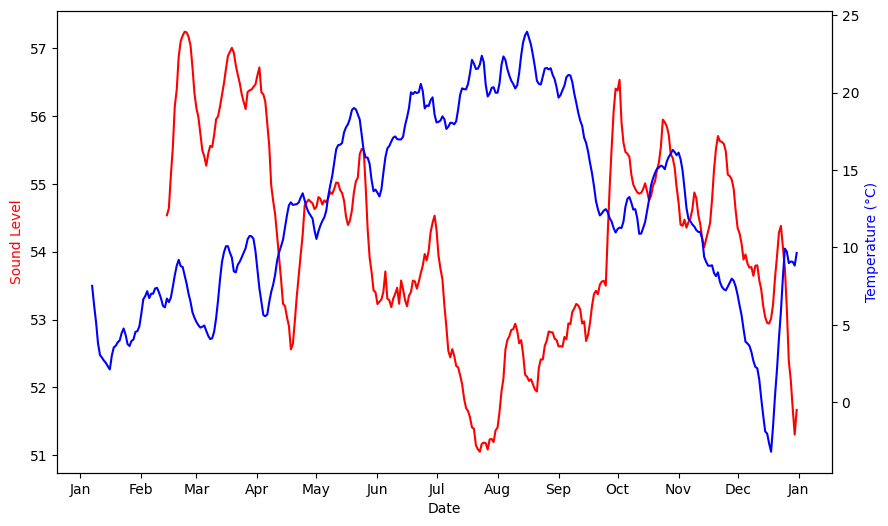

In [5]:
double_lineplot(Sound_Weather_day,'avg_laf25_per_hour','avg_LC_TEMP_QCL3','Date','Date','Sound Level','Temperature (°C)')

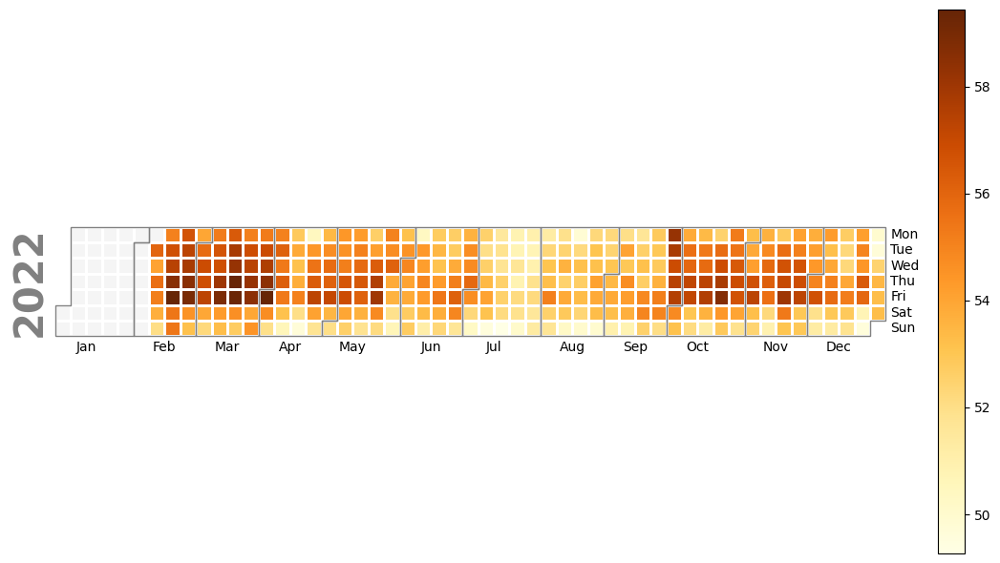

In [6]:
fig_df=pd.concat([(pd.DataFrame(index=range(38),columns=daily_sound.columns)),daily_sound],ignore_index=True)

missing_day=pd.DataFrame({'Date':pd.date_range(start='2022-01-01',end='2022-02-07')})
fig_df['Date']=fig_df['Date'].fillna(missing_day['Date'])
fig_df['Date']=pd.to_datetime(fig_df['Date'],format='%Y-%m-%d %H:%M:%S')
Sound_calendar=pd.Series(fig_df.set_index('Date')['avg_laf25_per_hour'])
Calendarmap=calplot.calplot(Sound_calendar,dropzero='True',cmap='YlOrBr',figsize=(12,6), yearlabel_kws={'fontname':'sans-serif'})
Calendarmap[0].show()

In [9]:
##We import the Dataset 
Noise_class_perhour=noiseprocessing(read_data(dirclass,';'))

##All the hours are changed into round hours
Noise_class_perhour['Date_time']= noiseprocessing(read_data(dirclass,';'))['Date_time'].apply(lambda a: min00(a))
#Classifications with less than 50% certainty are being discarded
Noise_class_perhour=Noise_class_perhour.loc[(Noise_class_perhour['Certainty']>=50)]
#We create a column 'Count', equal to one. This will make the computation of our event classifications easier. 
Noise_class_perhour.loc[:,'count']=1

pivot=pd.pivot_table(Noise_class_perhour,values='count', index=['Date_time','Location'],columns='Class',aggfunc='count')
#The dataset is filled with missing values for the hours in which no events were detected, we want those to be equal to 0 instead and get rid of the double index set above. 
pivot=pivot.fillna(0).reset_index(level=['Date_time','Location'])


#For the sake of readability and use we rename the columns
pivot.rename(columns={'Human voice - Shouting':'Shouting','Human voice - Singing':'Singing','Music non-amplified':'Music','Nature elements - Wind':'Wind','Transport road - Passenger car':'Car','Transport road - Siren':'Siren'},inplace=True)
#Create a list of the detected noise, just in case. 
detected_noise=['Shouting', 'Singing', 'Music', 'Wind', 'Car','Siren']

#One again we read the data 
Events=read_data(direvent,',')

#Rename several columns
Events.rename(columns={'Einde':'End','Soort':'Sort','Categorie':'Category','Locatie':'Location','Id':'id'},inplace=True)

#We remove those evetns who start on different periods. And we  convert the start and end date columns into pandas datetime foramt 
Events=Events[Events['Start']!='meerdere periodes']
for i in ['Start','End']:
    Events[str(i)]=pd.to_datetime(Events[str(i)],format='%d-%m-%Y %H:%M')

#We drop duplicate events
Events=Events.sort_values('End',ascending=True).drop_duplicates(subset='id',keep='last')

#We will keep the events that solely happen in Naamsestraat
#Strictly Naamsestraat
Top_left=[173230.000000,174395.00000]
Bottom_left=[173230.000000,173230.0000]
Top_right=[173500.00000,174395.00000]
Bottom_right=[173500.000000,173230.0000]


#Broad Naamsestraat
# Top_left=[17300.0000,174760.0000] 
# Bottom_left=[17300.0000,173345.0000] 
# Top_right=[174375.0000,174760.0000] 
# Bottom_right=[174375.0000,173345.0000] 


#Roughly Leuven's coordinate
# Top_left=[171933.0000,175720.0000] 
# Bottom_left=[171933.0000,171765.0000] 
# Top_right=[175325.0000,175720.0000] 
# Bottom_right=[175325.0000,171765.0000] 

R_limit=Bottom_right[0]
Down_limit=Bottom_right[1]
L_limit=Top_left[0]
Up_limit=Top_left[1]

#if the coordonates happen to be in the rectangle specified above we keep the event. Since the coordinate column contains strings this need some manipulation. 
Events['Coordinates']=Events['Location'].apply(lambda x: get_coord(x))

#We create a dummy varaible, equal to one if the veent is within the area around naamsestraat
Events['In_limit']=Events['Coordinates'].apply(lambda x: inbound(R_limit,Down_limit,L_limit,Up_limit,x))

Events=Events[Events['In_limit']==1].drop(['Location','In_limit','Category'],axis=1)

#We create a dataset with hours throughout the year 2022.
start_date = datetime.datetime(2022, 1, 1)
end_date = datetime.datetime(2022, 12, 31, 23, 59)
date_range = pd.date_range(start=start_date, end=end_date, freq='H')
Year_events=pd.DataFrame()
Year_events['Date_time']=date_range

# Year_events['Events_info']= ''
Year_events['Event_type']=''



#If a given hour lays between the start and end date of an event, such event will be added in a list which will fill the empty value of the Year_events Dataframe. 
for index, row in Year_events.iterrows(): 
    current_hour=row['Date_time']
    matching_events= Events[(current_hour>=(Events['Start'])) & (current_hour <= (Events['End']))]
  
    event_type_list=matching_events['Sort'].tolist()
    
    Year_events.at[index, 'Event_type'] = event_type_list



#We create a new column for each type of events. The value in that column is the amount of time that event appears in the list. 
#Hence, the amount of that type of event happening around Naamsestraat At that given hour. 
for sort in event_type_list:
    Year_events[f'{sort}']=Year_events['Event_type'].apply(lambda x: event_type_freq(f'{sort}',x))



Sound_weather= pd.merge(Sound,pivot,on=['Date_time','Location'],how='left').fillna(0).merge((Year_events.drop('Event_type',axis=1)),on=['Date_time'],how='left').merge(Meteo,on=['Date_time'],how='left')

#To that we make some adjustements, essentially minor feature engeneering such as:

#Extracting the month of the year
Sound_weather['Month'] = Sound_weather['Date_time'].apply(lambda w: w.strftime('%B'))

#The day of the week
Sound_weather['Day_of_week'] = Sound_weather['Date_time'].apply(lambda w: w.strftime('%A'))

#And the hour of the day 
Sound_weather['Hour']=Sound_weather['Date_time'].dt.hour.astype(str)


#One specific date and time appears twice, we therefore delete the duplicates 
Sound_weather=Sound_weather.drop_duplicates(['Date_time','Location'],keep='last')

#Sort the dataframe for upcoming manipulations
Sound_weather=Sound_weather.sort_values(['Location','Date_time'])

#And create an index from one to 50320, sorted by Location and Date_time
Sound_weather.reset_index(drop=True, inplace=True)


#The approach we are taking to do so is creating a column upon which we will index our cummulative sum. 
#Therefore, for every location, every sequence of 12:00 get assigned a index. 
Sound_weather['ind']=''

#In the loop below, n is the index. n is 0, until either one of those two conditions are met: 
#Either, it is 12:00 or if the Location in a row is different than the previous one. 

# (Remember, we sorted the dataset by Location, and Time. Meaning if we itterate through the rows, Location will change. 
# If the  sum was to go on, one location's detected sources of noise on Naamsestraat would carry on being summed on another on the count of another one. Which, we want to avoid)
n=0
for index, i in Sound_weather.iterrows():
    if index==0: 
        Sound_weather.loc[index, "ind"]=n
    else :
        if str(i['Time'])=='12:00:00' or i['Location']!= Sound_weather.loc[(index-1),'Location']:
            n+=1
            Sound_weather.loc[index, "ind"] = n
        else:
            Sound_weather.loc[index, "ind"]=n


#First we need to shift all our counts of noise by one row down, (for the reason explain above). 
#We then apply the cummulative sum of the shifted count of noise source on our index above. 
for source in detected_noise: 
    Sound_weather[f'shifted_{source}']=Sound_weather.sort_values(['ind','Date_time'])[[f'{source}']].shift(periods=1)
    Sound_weather.loc[0,f'shifted_{source}']=0 #---> Since we shift our column, the first instance is 0, and we loose the last one. 
    Sound_weather[f'cum_{source}']=Sound_weather.sort_values(['ind','Date_time']).groupby(['ind'])[f'shifted_{source}'].cumsum()
 

#We transform the dataset to have our percentile variables as single instances, we transform columns into rows essentially. 
Individual_Record=Sound_weather.melt(id_vars=(Sound_weather.filter(regex=r'^(?!laf)').columns)).drop(
             ['Date_time','Date','Time','id','shifted_Siren', 'shifted_Car','shifted_Singing','ind','Shouting', 'Singing', 'Music',
            'Wind', 'Car', 'Siren','shifted_Shouting','shifted_Wind','shifted_Music'],axis=1)

#We compute the variable, 'Sound duration' which essentially the amount of time a percentile would correspond to in minutes. The 25th percentile corresponding to 15 minutes. 
Individual_Record['Sound_duration']=(Individual_Record['variable'].apply(lambda a: (
    float(re.findall('\d+',a)[0])/1000) if a in ['laf005_per_hour','laf995_per_hour'] else (float(re.findall('\d+',a)[0])/100)))*60

#This is WHO's recomendation for maximal time of exposure for a given sound level. unfortunately, given the nature of the data, very little amount of observations fit that category. 
#Source: https://www.engineeringtoolbox.com/noise-exposure-level-duration-d_717.html
Individual_Record['max_time_of_exposure']=(480/(2**((Individual_Record['value']-85)/3)))

#Here we drop the final variables we won't need
training_set=(Individual_Record[Individual_Record.filter(regex=r'^(?!value)').columns]).drop(['variable','max_time_of_exposure'],axis=1)


#We define our numerical columns and categoricals ones for later on in our model. 
numeric_cols=training_set[training_set.filter(regex=r'^(?!value)').columns].select_dtypes(include=['float','int']).columns
categorical_cols=training_set[training_set.filter(regex=r'^(?!value)').columns].select_dtypes(include=['object']).columns

# print(' Our model will have the following numerical input variables :' )
# print(*numeric_cols)
# print('')
# print('And categorical variables: ' )
# print(*categorical_cols)

In [10]:
y=pd.DataFrame(Individual_Record['value'])
#Train and test split
X_train,X_test,y_train,y_test= train_test_split(training_set,y,test_size=0.15,shuffle=True)

#Sklearn MLP_predictor

numeric_transformer=Pipeline([("scaler",StandardScaler())])
Categorical_transformer=Pipeline([("Dummy_encoder",OneHotEncoder())])
preprocessor= ColumnTransformer([('numeric_preprocessing',numeric_transformer,numeric_cols),
                                    ('categorical_preprocessing',Categorical_transformer,categorical_cols)])
MLP_predictor= MLPRegressor( 
    activation='relu',
    random_state=36,
    hidden_layer_sizes=(80,30,10),
    learning_rate='invscaling',
    learning_rate_init=0.01,
    max_iter=100,
    early_stopping=True) 


In [ ]:

MLP_pipeline=pickle.load(open(MLP_file_sav, 'rb'))

predictions=MLP_pipeline.predict(X_test)

Regr_result=X_test
Regr_result['Predictions']=predictions
Regr_result['True_values']=y_test['value']
Regr_result['Residuals']=Regr_result['True_values']-Regr_result['Predictions']

Resi_plot= px.scatter(Regr_result,x='True_values',y='Residuals',labels={'x':'True_values','y':'Residuals'},color='Residuals', color_continuous_scale=px.colors.cyclical.Edge)
Resi_plot.show()

In [ ]:
predi_plot= px.scatter(Regr_result,x='True_values',y='Predictions',labels={'x':'True_values','y':'Predictions'},color='True_values', color_continuous_scale=px.colors.cyclical.Edge)

predi_plot.add_shape(
    type="line", line=dict(dash='dash'),
    x0=y.min(), y0=y.min(),
    x1=y.max(), y1=y.max()
)
predi_plot.show()

In [ ]:
Sound_weather=pd.read_csv(Sound_weather_file,index_col=0)

#We create a new dataframe without the lowest percentiles
Class_nuisance=Sound_weather.drop(['laf005_per_hour','laf01_per_hour'],axis=1)


'''Feel free to play around with the noise treshold, the value inside the gt() function, it does change the class repartition which affect the model quite a bit'''
#We initialise our class, equal to one when both conditions mentioned above are 
Class_nuisance['Nuisance'] = (Class_nuisance[Class_nuisance.filter(regex='laf').columns].gt(65).any(axis=1)) & (Class_nuisance['Time_of_Day'] == 'Night').astype(int)
Class_nuisance['Hour'] = Class_nuisance['Hour'].astype(str)

Class_nuisance=Class_nuisance.loc[Class_nuisance['Time_of_Day']=='Night']

Class_trainingset=Class_nuisance.drop(Class_nuisance.filter(regex='laf').columns,axis=1).drop(
    #We drop the variable than are either not relevant, that would result in too many dummy variables when one hot encoded or  that one would realistically not have access toat prediction time
    ['Date_time','Date','id','Time','id','ind','Shouting', 'Singing', 'Music','Wind', 'Car', 'Siren'],axis=1)

print('Only keeping the observations at night leaves us with a total of ' + str(len(Class_trainingset)) + ' among which ' + str(Class_nuisance.Nuisance.sum()) + ' are potentially disturbing.')

#Once again we define our numerical and categorical
numeric_cols=Class_trainingset[Class_trainingset.filter(regex=r'^(?!value)').columns].select_dtypes(include=['float','int']).columns
categorical_cols=Class_trainingset[Class_trainingset.filter(regex=r'^(?!value)').columns].select_dtypes(include=['object']).columns

#Create our training and test set 
X_class=Class_trainingset.drop('Nuisance',axis=1)
y_class=Class_trainingset['Nuisance']
ClassX_train, ClassX_test, Classy_train, Classy_test= train_test_split(X_class,y_class,test_size=0.2,shuffle=True)

#A small fraction of the dataset will be set aside to validate our model
ClassX_test, ClassX_val, Classy_test, Classy_val= train_test_split(ClassX_test,Classy_test,test_size=0.05,shuffle=True)


# print(' Our model will have the following numerical input variables:' )
# print(*numeric_cols)
# print('')
# print('And categorical variables: ' )
# print(*categorical_cols)

Only keeping the observations at night leaves us with a total of 18882 among which 2017 are potentially disturbing.


In [14]:
#Classifier:

numeric_transformer=Pipeline([("scaler",StandardScaler())])
Categorical_transformer=Pipeline([("Dummy_encoder",OneHotEncoder(handle_unknown='ignore'))])
preprocessor= ColumnTransformer([('numeric_preprocessing',numeric_transformer,numeric_cols),
                                 ('categorical_preprocessing',Categorical_transformer,categorical_cols)])
MLP_classifier= MLPClassifier( 
    activation='tanh',
    hidden_layer_sizes=(100,80,30,20),
    learning_rate='invscaling',
    learning_rate_init=0.001,
    max_iter=1000

)

MLP_Class_pipeline=pickle.load(open(MLP_classifier_file,'rb'))




In [ ]:
MLP_predicitons=MLP_Class_pipeline.predict(ClassX_test)
results=precision_recall_fscore_support(Classy_test,MLP_predicitons)


FP,FN,TP,TN=True_False_positive(Classy_test,MLP_predicitons)

print('The model was tested on a dataset containing ' + str(results[3][1]) + ' classified as Nuisances on a total of ' + str(results[3][0]) + ' observations')
print('The precision of our model is the following for our class of interest: ' + str(results[0][1]) +'. The precision is intuitively the ability of the classifier not to label a negative sample as positive.')
print('The recall of our model is the following for our class of interest: '+ str(results[1][1])+ '. The recall is intuitively the ability of the classifier to find all the positive samples.')

print('We get '+ str(FP[1]) + ' False positives, ' + str(FN[1]) + ' False negatives, '+ str(TP[1]) + ' True positives, '+ str(TN[1]) + ' True negatives.' )
print('In total, our model predicted ' + str(FP[1] + FN[1]) +' outcomes wrong')

The model was tested on a dataset containing 381 classified as Nuisances on a total of 3207 observations
The precision of our model is the following for our class of interest: 0.9921671018276762. The precision is intuitively the ability of the classifier not to label a negative sample as positive.
The recall of our model is the following for our class of interest: 0.9973753280839895. The recall is intuitively the ability of the classifier to find all the positive samples.
We get 3 False positives, 1 False negatives, 380 True positives, 3204 True negatives.
In total, our model predicted 4 outcomes wrong


In [ ]:

MLP_proba=MLP_Class_pipeline.predict_proba(ClassX_test)
plot_class_proba(Class_nuisance,Classy_test,MLP_predicitons,MLP_proba)

In [ ]:
warnings.filterwarnings("ignore", category=Warning, module="tensorflow")
Sound_weather=pd.read_csv(Sound_weather_file,index_col=0)

COLUMNS_TO_KEEP=['Date_time', 'Location', 'Vacation', 'Time_of_Day',
       'Shouting', 'Singing', 'Music', 'Wind', 'Car', 'Siren', 'Evenement',
       'Werk', 'Grondwerk', 'avg_LC_HUMIDITY', 'avg_LC_RAD', 'avg_LC_RAININ',
       'avg_LC_DAILYRAIN', 'avg_LC_WINDDIR', 'avg_LC_WINDSPEED',
       'avg_LC_TEMP_QCL3', 'Month', 'Day_of_week', 'Hour']
print(*COLUMNS_TO_KEEP)



X_seqtrain, X_seqtest, y_seqtrain, y_seqtest,X_seqval,y_seqval=Preprocess_to_sequence(Sound_weather,COLUMNS_TO_KEEP,'laf25_per_hour',window=24)

set_dict={}

list_ysets=[y_seqtrain,y_seqtest,y_seqval]
keys=['train','test','val']

for i, set_array in enumerate(list_ysets):
    key=keys[i]
    set_dict[key] = set_array[:,[0,1]]

y_seqtrain,y_seqtest,y_seqval=np.delete(y_seqtrain, [0,1], axis=1).astype('float32'),np.delete(y_seqtest, [0,1], axis=1).astype('float32'),np.delete(y_seqval, [0,1], axis=1).astype('float32')




Date_time Location Vacation Time_of_Day Shouting Singing Music Wind Car Siren Evenement Werk Grondwerk avg_LC_HUMIDITY avg_LC_RAD avg_LC_RAININ avg_LC_DAILYRAIN avg_LC_WINDDIR avg_LC_WINDSPEED avg_LC_TEMP_QCL3 Month Day_of_week Hour
With those columns as numeric variables
Shouting Singing Music Wind Car Siren Evenement Werk Grondwerk avg_LC_HUMIDITY avg_LC_RAD avg_LC_RAININ avg_LC_DAILYRAIN avg_LC_WINDDIR avg_LC_WINDSPEED avg_LC_TEMP_QCL3
With those columns as categorical variables
Location Vacation Time_of_Day Month Day_of_week Hour


In [ ]:
print('Our training set has a the following shape', X_seqtrain.shape)

History=pickle.load(open(History_LSTM_file, 'rb'))
LSTM_Model = tf.keras.models.load_model(LSTM_checkpoint)
LSTM_Model.summary()

PREDICTIONS=(LSTM_Model.predict(X_seqval).flatten())
RESIDUALS=y_seqval.flatten()-PREDICTIONS
LOCATION_VAL=(set_dict['val'][:,0]).flatten()
DATE_TIME_VAL=pd.to_datetime(((set_dict['val'][:,1])).flatten())
LSTM_result=pd.DataFrame(data={'Predictions':PREDICTIONS,'True_values':(y_seqval.flatten()),'Location':LOCATION_VAL,'Date_time':DATE_TIME_VAL,'Residuals':RESIDUALS})
LSTM_result.head(n=5)

Our training set has a the following shape (32579, 24, 73)
Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_3 (LSTM)               (None, 60)                32160     
                                                                 
 dense_7 (Dense)             (None, 40)                2440      
                                                                 
 dense_8 (Dense)             (None, 16)                656       
                                                                 
 dense_9 (Dense)             (None, 1)                 17        
                                                                 
Total params: 35,273
Trainable params: 35,273
Non-trainable params: 0
_________________________________________________________________
83/83 [==============================] - 1s 4ms/step


,Predictions,True_values,Location,Date_time,Residuals
0,57.793941,58.299999,His & Hears,2022-12-26 13:00:00,0.506058
1,59.081821,59.700001,His & Hears,2022-11-05 14:00:00,0.618179
2,57.976955,57.299999,Naamsestraat 62 Taste,2022-11-23 23:00:00,-0.676956
3,53.118942,55.599998,Naamsestraat 81,2022-03-17 00:00:00,2.481056
4,50.882023,52.200001,Naamsestraat 62 Taste,2022-10-22 03:00:00,1.317978


In [19]:
MSE=mean_squared_error(y_seqval.flatten(),PREDICTIONS)
print('Our model\'s mean squared error is equal to ' + str(mean_squared_error(y_seqval.flatten(),PREDICTIONS)) + ', while our test set\'s was of ' + str(np.min(History.history['val_mse'])))

Our model's mean squared error is equal to 3.052123, while our test set's was of 4.00227165222168


In [ ]:

fig2= px.scatter(LSTM_result,x='True_values',y='Predictions',labels={'x':'True_values','y':'Predictions'},color='Residuals', color_continuous_scale=px.colors.cyclical.Edge)
fig2.add_shape(
    type="line", line=dict(dash='dash'),
    x0=LSTM_result['Predictions'].min(), y0=LSTM_result['Predictions'].min(),
    x1=LSTM_result['Predictions'].max(), y1=LSTM_result['Predictions'].max(),
    layer='above'
)
fig2.show()

In [ ]:
fig3= px.scatter(LSTM_result,x='True_values',y='Residuals',labels={'x':'True values','y':'Residuals'},color=LSTM_result['Residuals'], color_continuous_scale=px.colors.cyclical.Edge)
fig3.show()

In [ ]:
plot_predictions(LSTM_result,n_obs=300).show()

In [ ]:
residuals_by(LSTM_result,'Date').show()